# Task 6.3 Geographical Visualization




### This script contains the following:

#### Step 1. Import Data and Libraries
#### Step 2. Data Wrangling
#### Step 3. Data Cleaning
#### Step 4. Plotting a Choropleth


### Step 1: Import Data and Libraries


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import os
import folium
import json

In [2]:
#This command propts matplotlib visuals to appear in the notebook;

%matplotlib inline

In [3]:
#Step 1.1: Creating a Folderpath for Citibike_Final Dataset; 

path ='/users/ibu/Documents/Bike Rental Analysis'

In [4]:
#Step 1.2: Importing 'Citibike_Final' Dataset from 'Prepared' Data Folder;

df_bikes = pd.read_csv(os.path.join(path, '02 Data', 'Prepared', 'Citibike_T62.csv'), index_col = False)

In [5]:
#Step 1.3a: Checking Shape & Dimension; 

df_bikes.head()

,Unnamed: 0,Bike_ID,Weekday,Start_Hour,Start_Time,Start_Station_ID,Start_Station_Name,Start_Station_Latitude,Start_Station_Longitude,End_Time,End_Station_ID,End_Station_Name,End_Station_Latitude,End_Station_Longitude,Trip_Duration,Member_Status,Gender,Distance
0,0,16013,Mon,18,9/9/13 18:18,523,W 38 St & 8 Ave,40.754666,-73.991382,9/9/13 18:35,334,W 20 St & 7 Ave,40.742388,-73.997262,993,Subscriber,Female,High_Latitude
1,1,15230,Thu,18,9/12/13 18:38,257,Lispenard St & Broadway,40.719392,-74.002472,9/12/13 18:48,236,St Marks Pl & 2 Ave,40.728419,-73.987140,581,Subscriber,Male,Mid_Latitude
2,2,17942,Wed,19,9/18/13 19:44,479,9 Ave & W 45 St,40.760193,-73.991255,9/18/13 19:50,513,W 56 St & 10 Ave,40.768254,-73.988639,361,Subscriber,Male,High_Latitude
3,3,19683,Sat,11,9/28/13 11:54,527,E 33 St & 1 Ave,40.743156,-73.974347,9/28/13 12:03,441,E 52 St & 2 Ave,40.756014,-73.967416,561,Subscriber,Female,High_Latitude
4,4,18024,Sat,18,9/7/13 18:08,521,8 Ave & W 31 St,40.750450,-73.994811,9/7/13 18:46,476,E 31 St & 3 Ave,40.743943,-73.979661,2296,Non-Subscriber,Unknown,High_Latitude


In [6]:
#Step 1.3b: Checking Shape & Dimension; 

df_bikes.shape

(50000, 18)

In [7]:
df_bikes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               50000 non-null  int64  
 1   Bike_ID                  50000 non-null  int64  
 2   Weekday                  50000 non-null  object 
 3   Start_Hour               50000 non-null  int64  
 4   Start_Time               50000 non-null  object 
 5   Start_Station_ID         50000 non-null  int64  
 6   Start_Station_Name       50000 non-null  object 
 7   Start_Station_Latitude   50000 non-null  float64
 8   Start_Station_Longitude  50000 non-null  float64
 9   End_Time                 50000 non-null  object 
 10  End_Station_ID           50000 non-null  int64  
 11  End_Station_Name         50000 non-null  object 
 12  End_Station_Latitude     50000 non-null  float64
 13  End_Station_Longitude    50000 non-null  float64
 14  Trip_Duration         

In [8]:
#Step 1.4: Import ".json" file for the City of New York;

NYC_Cities ='/users/ibu/Desktop/Unit 6/Task 6.3/NYC_Cities_json_Dataset/NYC_Bike_Routes.geojson' 


In [9]:
NYC_Cities 

'/users/ibu/Desktop/Unit 6/Task 6.3/NYC_Cities_json_Dataset/NYC_Bike_Routes.geojson'

In [10]:
#Step 1.5: Checking the 'JSON' file content;

f = open('/users/ibu/Desktop/Unit 6/Task 6.3/NYC_Cities_json_Dataset/NYC_Bike_Routes.geojson',)


#Loading JSON object as Dictionary;

data = json.load(f)


#Printing Data Results; 

for i in data['features']:
    print(i)


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'type': 'Feature', 'properties': {'bikedir': '2', 'fromstreet': 'BROOKFIELD PARK ENTRY DRIVE', 'lanecount': '2', 'facilitycl': 'I', 'ft2facilit': None, 'tf2facilit': None, 'tostreet': 'BROOKFIELD PARK GWY', 'tf_facilit': 'Dirt Path', 'allclasses': 'I', 'onoffst': 'OFF', 'ft_facilit': 'Dirt Path', 'boro': '5', 'street': 'BROOKFIELD PARK GWY', 'shape_le_1': '1762.96920854', 'segmentid': '0', 'comments': None}, 'geometry': {'type': 'MultiLineString', 'coordinates': [[[-74.15825388525826, 40.56445191244708], [-74.15730216299414, 40.565393373187135], [-74.15714377343664, 40.565539161914174], [-74.15697979635296, 40.565681312724706], [-74.15681037550472, 40.56581970112607], [-74.15663565938974, 40.5659542062212], [-74.15652126077975, 40.5660551806144], [-74.15640113965442, 40.566152213875405], [-74.15627553055802, 40.56624511745723], [-74.15614467632463, 40.566333710906584], [-74.15600883162453, 40.566417823660196], [-74.15586826059005, 40.56649728964523], [-74.15572323447691, 40.5665719571


### Step 2: Data Wrangling


In [11]:
#Step 2.1: Dropping Unnecessary Columns; 

df_bikes = df_bikes.drop(columns = ['Unnamed: 0'])

In [12]:
df_bikes

,Bike_ID,Weekday,Start_Hour,Start_Time,Start_Station_ID,Start_Station_Name,Start_Station_Latitude,Start_Station_Longitude,End_Time,End_Station_ID,End_Station_Name,End_Station_Latitude,End_Station_Longitude,Trip_Duration,Member_Status,Gender,Distance
0,16013,Mon,18,9/9/13 18:18,523,W 38 St & 8 Ave,40.754666,-73.991382,9/9/13 18:35,334,W 20 St & 7 Ave,40.742388,-73.997262,993,Subscriber,Female,High_Latitude
1,15230,Thu,18,9/12/13 18:38,257,Lispenard St & Broadway,40.719392,-74.002472,9/12/13 18:48,236,St Marks Pl & 2 Ave,40.728419,-73.987140,581,Subscriber,Male,Mid_Latitude
2,17942,Wed,19,9/18/13 19:44,479,9 Ave & W 45 St,40.760193,-73.991255,9/18/13 19:50,513,W 56 St & 10 Ave,40.768254,-73.988639,361,Subscriber,Male,High_Latitude
3,19683,Sat,11,9/28/13 11:54,527,E 33 St & 1 Ave,40.743156,-73.974347,9/28/13 12:03,441,E 52 St & 2 Ave,40.756014,-73.967416,561,Subscriber,Female,High_Latitude
4,18024,Sat,18,9/7/13 18:08,521,8 Ave & W 31 St,40.750450,-73.994811,9/7/13 18:46,476,E 31 St & 3 Ave,40.743943,-73.979661,2296,Non-Subscriber,Unknown,High_Latitude
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,17988,Sat,18,9/21/13 18:39,479,9 Ave & W 45 St,40.760193,-73.991255,9/21/13 20:08,478,11 Ave & W 41 St,40.760301,-73.998842,2697,Non-Subscriber,Unknown,High_Latitude
49996,18458,Sat,17,9/14/13 17:32,261,Johnson St & Gold St,40.694749,-73.983625,9/14/13 17:52,151,Cleveland Pl & Spring St,40.721816,-73.997203,1191,Subscriber,Female,Low_Latitude
49997,15054,Sat,18,9/7/13 18:08,402,Broadway & E 22 St,40.740343,-73.989551,9/7/13 18:25,524,W 43 St & 6 Ave,40.755273,-73.983169,1050,Subscriber,Female,High_Latitude
49998,16763,Sat,13,9/7/13 13:25,271,Ashland Pl & Hanson Pl,40.685282,-73.978058,9/7/13 14:14,373,Willoughby Ave & Walworth St,40.693317,-73.953820,2697,Non-Subscriber,Unknown,Low_Latitude


In [13]:
#Step 2.2: Selection of Specific Columns List;  

Columns = ["Weekday",
           "Start_Time",
           "End_Time",
           "Start_Station_Name",
           "End_Station_Name",
           "Gender",
           "Distance",
           "Trip_Duration",
           "Member_Status"]

In [14]:
#Step 2.3: Creating a Subset; 

Rider_Gender = df_bikes[Columns]

In [15]:
Rider_Gender.head()

,Weekday,Start_Time,End_Time,Start_Station_Name,End_Station_Name,Gender,Distance,Trip_Duration,Member_Status
0,Mon,9/9/13 18:18,9/9/13 18:35,W 38 St & 8 Ave,W 20 St & 7 Ave,Female,High_Latitude,993,Subscriber
1,Thu,9/12/13 18:38,9/12/13 18:48,Lispenard St & Broadway,St Marks Pl & 2 Ave,Male,Mid_Latitude,581,Subscriber
2,Wed,9/18/13 19:44,9/18/13 19:50,9 Ave & W 45 St,W 56 St & 10 Ave,Male,High_Latitude,361,Subscriber
3,Sat,9/28/13 11:54,9/28/13 12:03,E 33 St & 1 Ave,E 52 St & 2 Ave,Female,High_Latitude,561,Subscriber
4,Sat,9/7/13 18:08,9/7/13 18:46,8 Ave & W 31 St,E 31 St & 3 Ave,Unknown,High_Latitude,2296,Non-Subscriber


In [16]:
Rider_Gender.shape

(50000, 9)


### Step 3: Data Cleaning


In [17]:
#Step 3.1: Checking Subset for Nulls;

Rider_Gender.isnull().sum()

Weekday               0
Start_Time            0
End_Time              0
Start_Station_Name    0
End_Station_Name      0
Gender                0
Distance              0
Trip_Duration         0
Member_Status         0
dtype: int64

<b>Notes:</b> No missing values exists

In [18]:
#Step 3.2: Checking for Duplicates; 

Rider_Gender_Dups = Rider_Gender.duplicated()

In [19]:
Rider_Gender_Dups.shape

(50000,)

<b>Notes:</b> No Duplicates Found

<AxesSubplot:xlabel='Trip_Duration', ylabel='Count'>

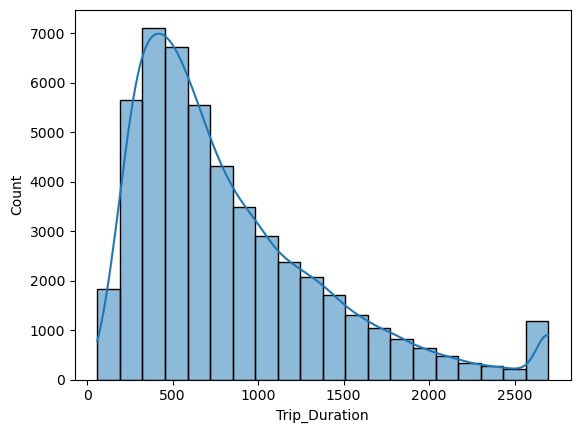

In [20]:
#Step 3.3: Checking for Extreme Values;

sns.histplot(Rider_Gender['Trip_Duration'], bins=20, kde = True)


### Step 4: Plotting a Choropleth


In [21]:
#Step 4.1: Setting up for Choropleth

Plot_Data = Rider_Gender[['Gender','Trip_Duration']]

In [22]:
Plot_Data.head(100)

,Gender,Trip_Duration
0,Female,993
1,Male,581
2,Male,361
3,Female,561
4,Unknown,2296
...,...,...
95,Female,407
96,Male,624
97,Male,459
98,Male,621


In [23]:
#Step 4.1b: Setting up for Choropleth

Plot_Data2 = Rider_Gender[['Start_Station_Name','Trip_Duration']]

In [24]:
Plot_Data2

,Start_Station_Name,Trip_Duration
0,W 38 St & 8 Ave,993
1,Lispenard St & Broadway,581
2,9 Ave & W 45 St,361
3,E 33 St & 1 Ave,561
4,8 Ave & W 31 St,2296
...,...,...
49995,9 Ave & W 45 St,2697
49996,Johnson St & Gold St,1191
49997,Broadway & E 22 St,1050
49998,Ashland Pl & Hanson Pl,2697


In [25]:
Rider_Gender['Weekday'].value_counts(1000)

Mon    0.15430
Sun    0.14638
Fri    0.14618
Wed    0.14456
Tue    0.14130
Thu    0.13714
Sat    0.13014
Name: Weekday, dtype: float64

In [26]:
#Step 4.2: Setting up a Folium Map at High-Level Zoom; 

map = folium.Map(location = [100, 0], zoom_start = 1.5)

# Choropleth maps bind Pandas Data Frames and json geometries.This allows us to quickly visualize data combinations
folium.Choropleth(
    geo_data = NYC_Cities, 
    data = Plot_Data,
    columns = ['Gender', 'Trip_Duration'],
    key_on = 'feature.properties.bikedir', # this part is very important - check your json file to see where the KEY is located
    fill_color = 'YlOrBr', fill_opacity=0.6, line_opacity=0.1,
    legend_name = "Trip_Duration").add_to(map)
folium.LayerControl().add_to(map)

map



### Step 5: Exporting Dataset

In [28]:
#Step 5.1: Exporting Updated 'df_Citibike_Clean' Dataset;

df_bikes.to_csv(os.path.join(path, '02 Data', 'Prepared', 'Citibike_T63.csv'))